# 1. Expresses the central motivation of the project in one or two sentences. This may evolve a bit through the project.

During this project, we want to be able to artificially generate a visual representation of sound-to-color synesthesia, a condition in which an individual sees colors in response to hearing specific noises. By translating frequencies into colors, we wish to create a program that can generate colors based on an inputted song. We can do this by training on a data set with .wav signals from a simple piano performance that are paired with color.

# Visualization 1

# Visualization 2

In [3]:
#---------------------------------Code taken from Lab 4 helper.py and edited-------------------------------------

import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from scipy.io import wavfile
from IPython.display import display, Audio

sns.set(font_scale=1.4)

class Sound:
    """ a sound, can be played, volume adjusted or appended

    Attributes:
        x (np.array): an array representing the sound. either
            1d (mono) or 2d (stereo) (see note above)
        rate (int): frequency, in hertz, that the signal x
            should be played at
    """

    def __init__(self, x, rate):
        self.x = x.astype(np.int16)
        self.rate = rate

    @classmethod
    def from_wav_file(cls, file):
        """ loads sound from a Wav file
        
        Args:
            file (str): file name (needn't have full path if
                file is in same folder as this ipynb)
        """
        rate, x = wavfile.read(str(file))
        return Sound(x=x, rate=rate)
    
    def to_wav_file(self, file):
        """ save sound to a Wav file
        
        Args:
            file (str): file name (needn't have full path if
                file is in same folder as this ipynb)
        """
        wavfile.write(file, self.rate, self.x)

    def build_jupyter_player(self):
        """ builds and displays jupyter player of sound """
        display(Audio((self.x[:, 0], self.x[:, 1]), 
                      rate=self.rate))
        
    def __mul__(self, other):
        """multiplies the audio signal by some constant
        
         Args:
            other (int or float): some scale to apply
        """
        assert float(other) >= 0, \
            'Sound can only be multiplied by positive values'
        assert type(other) in (int, float), \
            'Sound can only be multiplied by int or float'
        
        return Sound(x=self.x * other, rate=self.rate)

    def __and__(self, other):
        """appends one noise onto the end of another
        
        Args:
            other (obj): sound to append to original sound
        """
        assert self.rate == other.rate, \
            'Only Sound arrays of same rate can be appended'
        
        new_sound = np.append(self.x, other.x, axis=0)
        return Sound(x=new_sound, rate=self.rate)
    
    def __add__(self, other):
        """overlays one sound on top of another
        
         Args:
            other (obj): sound to overlay atop original sound
        """
        assert self.rate == other.rate, \
            'Only Sound arrays of same rate can be overlayed'
        
        # list to hold both arrays and array shapes
        array_ls = [self.x, other.x]
        array_sizes = [np.shape(self.x), np.shape(other.x)]
        
        # finding which is the smaller and larger array (if any)
        larger_array = max(array_sizes)
        smaller_array = min(array_sizes)
        
        # finding index of the smaller and larger array for easy access
        smaller_idx = array_sizes.index(smaller_array)
        larger_idx = array_sizes.index(larger_array)
        
        # calculates how much bigger the larger array
        difference = larger_array[0] - smaller_array[0]
        
        # appending array of zeroes to fill the difference amount between the arrays
        new_array = np.append(array_ls[smaller_idx], np.zeros((difference, 2)), axis = 0)
        
        # overlaying the arrays
        combined_array = array_ls[larger_idx] + new_array
        
        return Sound(x=combined_array, rate=self.rate)
    
    def plot(self, cutoffs=None, colors=None):
        """produces a graph of the audio signal
        
        Args:
            cutoffs (list of floats): values at which to change the color
            colors (list of str): corresponding colors for each section
        
        """
        ##############################
        '''Deleting right channel for mono sound'''
        self.x = self.x[:, 0]
        #FIXME: This line prevents .plot() from working multiple times as it keeps deleting the channel again and again.
        ##############################


        # set up time index array - this is a more accurate way to plot the signal as it would incorporate the rate (thx stackoverflow)
        time = np.arange(len(self.x)) / float(self.rate)
        
        if cutoffs is None:
            # if no cutoffs are provided, plot the whole signal in one color
            plt.plot(time, self.x)

        else:
            # plot each section of the signal with its own color
            if colors is None:
                colors = ['blue', 'green', 'red', 'purple', 'orange', 'black']
            colors = colors[:len(cutoffs) + 1]  # make sure we have enough colors
            
            start = 0
            for i, cutoff in enumerate(cutoffs):
                end = int(cutoff * self.rate)
                plt.plot(time[start:end], self.x[start:end], color=colors[i % len(colors)])
                start = end
                #end and start are used to plot the sections with different colors (shoutout to vedant from uw for this)
            
            # plot the last section
            plt.plot(time[start:], self.x[start:], color=colors[-1])
        
        # add labels and legend
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude') #this seems to be the more accurate way of saying this?

In [4]:
thud = Sound.from_wav_file(file='twinkle_twinkle.wav')

thud.build_jupyter_player()

/var/folders/d3/n20nc0sj0zn2sc1f6tzt1m000000gn/T/ipykernel_26341/3394886764.py:31: WavFileWarning: Reached EOF prematurely; finished at 9809999 bytes, expected 4294967303 bytes from header.
  rate, x = wavfile.read(str(file))


In [5]:
song_arr = thud.x

i = 0
stopping_idx = 0
while i < song_arr.shape[0]:
    x, y = song_arr[i, 0], song_arr[i, 1]
    if ((song_arr[i-1, 0] != 0) and (song_arr[i-1, 1] != 0)) and ((song_arr[i+1,0] != 0) and (song_arr[i+1,1] != 0)):
        stopping_idx = i-1
        break
    i += 1
stopping_idx

edited_song = np.random.randint(1, size=(song_arr.shape[0] - stopping_idx, 2))

j = stopping_idx
k = 0
while j < song_arr.shape[0] - stopping_idx: 
    edited_song[k] = song_arr[j]
    j += 1
    k += 1

thud.x = edited_song
thud.build_jupyter_player()

In [6]:
#very archaic method of getting one single sentence out of the song

edit = thud.x
edit_size = (edit.size)/2
ed = int(edit_size/7)
edit = edit[:ed]
thud.x = edit
thud.build_jupyter_player()

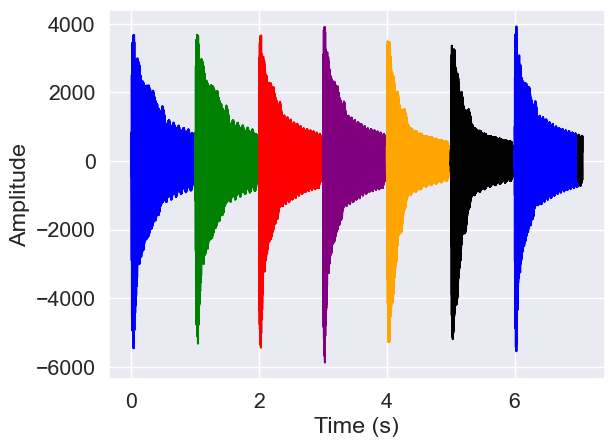

In [7]:
#plot of varying colors based on varying sounds
thud.plot(cutoffs=[1,2,3,4,5,6,7])

# Visualization 2
Through visualization 2 we are represented a basic version of what we intend our final project to produce -- a color varying plot over time based on characteristics of the noise being plotted. Though this visualization is created based on colors that are hard coded to corresponded to different sounds through a pre-made array, we intend to later have the color of the waveform be predicted by our program based on characteristics of the frequency and amplitude of the given waveform, creating a visualization with more diverse colors and waves representing what an individual with synthestia may experience while listening to music.

# 3. Discuss what ML tools will be used. Its expected that many (most) analyses will fail to produce the results you’re after. Be sure that your ML plans are flexible:

We will be using the Kmeans Clustering and KNN Classification. We would initially like to train on KNN Classification (on our simple piano .wav set) 
- challenging goals should build in “fallback” milestones in the event the stretch goal doesn’t work out as planned
- otherwise, include alternate analyses which might also be interesting